This notebook performs a thorough exploratory data analysis(EDA) on `Crime_Incidents_in_2024.csv`. 
It includes data loading, cleaning, missing-value analysis, visualization.

**What this notebook will produce:**
- Data Summary
- Missing value analysis
- Feature Distribution Analysis
- Removing unnecessary columns



In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


In [3]:
df=pd.read_csv('Crime_Incidents_in_2024.csv')
df.head()

,X,Y,CCN,REPORT_DAT,SHIFT,METHOD,OFFENSE,BLOCK,XBLOCK,YBLOCK,...,BLOCK_GROUP,CENSUS_TRACT,VOTING_PRECINCT,LATITUDE,LONGITUDE,BID,START_DATE,END_DATE,OBJECTID,OCTO_RECORD_ID
0,393525.51,140841.02,24112216,2024/07/22 14:03:32+00,DAY,OTHERS,THEFT F/AUTO,NEWARK STREET NW AND 38TH STREET NW,393525.51,140841.02,...,001002 4,1002.0,Precinct 29,38.935430,-77.074676,NaN,2024/07/22 02:00:00+00,2024/07/22 10:30:00+00,820518541,NaN
1,394459.18,141888.04,24184123,2024/11/27 02:06:10+00,EVENING,OTHERS,THEFT/OTHER,4227 - 4399 BLOCK OF CONNECTICUT AVENUE NW,394459.18,141888.04,...,001303 1,1303.0,Precinct 34,38.944869,-77.063916,NaN,2024/11/27 01:20:00+00,2024/11/27 01:22:00+00,820518555,NaN
2,405970.94,137259.39,24000883,2024/01/02 19:50:08+00,DAY,OTHERS,MOTOR VEHICLE THEFT,4900 - 4929 BLOCK OF SHERIFF ROAD NE,405970.94,137259.39,...,007809 1,7809.0,Precinct 94,38.903169,-76.931163,NaN,2024/01/02 18:09:00+00,NaN,820518557,NaN
3,399952.66,134206.09,24096206,2024/06/24 15:15:01+00,DAY,OTHERS,THEFT/OTHER,1200 - 1299 BLOCK OF 4TH STREET SE,399952.66,134206.09,...,007201 2,7201.0,Precinct 131,38.875684,-77.000546,CAPITOL RIVERFRONT,2023/12/22 00:50:00+00,2023/12/22 18:00:00+00,820518559,NaN
4,394449.15,137479.06,24030435,2024/02/27 22:23:40+00,EVENING,OTHERS,THEFT/OTHER,3200 - 3275 BLOCK OF M STREET NW,394449.15,137479.06,...,000202 4,202.0,Precinct 6,38.905151,-77.063996,GEORGETOWN,2024/02/27 21:47:00+00,2024/02/27 21:58:00+00,820518590,NaN


In [4]:
print("Shape of the dataset:", df.shape )
df.info()



Shape of the dataset: (29284, 25)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29284 entries, 0 to 29283
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   X                     29284 non-null  float64
 1   Y                     29284 non-null  float64
 2   CCN                   29284 non-null  int64  
 3   REPORT_DAT            29284 non-null  object 
 4   SHIFT                 29284 non-null  object 
 5   METHOD                29284 non-null  object 
 6   OFFENSE               29284 non-null  object 
 7   BLOCK                 29284 non-null  object 
 8   XBLOCK                29284 non-null  float64
 9   YBLOCK                29284 non-null  float64
 10  WARD                  29280 non-null  float64
 11  ANC                   29280 non-null  object 
 12  DISTRICT              28548 non-null  float64
 13  PSA                   28822 non-null  float64
 14  NEIGHBORHOOD_CLUSTER  29280 non-null

In [5]:

df.isna().sum()

X                           0
Y                           0
CCN                         0
REPORT_DAT                  0
SHIFT                       0
METHOD                      0
OFFENSE                     0
BLOCK                       0
XBLOCK                      0
YBLOCK                      0
WARD                        4
ANC                         4
DISTRICT                  736
PSA                       462
NEIGHBORHOOD_CLUSTER        4
BLOCK_GROUP                13
CENSUS_TRACT               13
VOTING_PRECINCT             4
LATITUDE                    0
LONGITUDE                   0
BID                     23870
START_DATE                  5
END_DATE                 2094
OBJECTID                    0
OCTO_RECORD_ID          29284
dtype: int64

In [6]:
data=df.drop(['BID', 'OCTO_RECORD_ID'], axis=1, inplace=True)



In [7]:
df.dropna(subset=['WARD','ANC','NEIGHBORHOOD_CLUSTER','VOTING_PRECINCT','START_DATE','BLOCK_GROUP','CENSUS_TRACT'],inplace=True)

In [8]:
# Fill missing DISTRICT with most frequent value within each WARD
df['DISTRICT'] = df.groupby('WARD')['DISTRICT'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else x)
)

# Fill missing PSA with most frequent value within each DISTRICT
df['PSA'] = df.groupby('DISTRICT')['PSA'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else x)
)

To handle missing values in the administrative fields `DISTRICT` and `PSA`, using group-based mode imputation, which preserves local administrative structure and improves accuracy compared to filling with a global mode.

In [9]:
print(df[['DISTRICT', 'PSA']].isna().sum())

DISTRICT    0
PSA         0
dtype: int64


In [10]:
df['END_DATE'].fillna(df['START_DATE'], inplace=True)
df.isna().sum()

C:\Users\Akhila Ulpara\AppData\Local\Temp\ipykernel_11008\3737961225.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['END_DATE'].fillna(df['START_DATE'], inplace=True)


X                       0
Y                       0
CCN                     0
REPORT_DAT              0
SHIFT                   0
METHOD                  0
OFFENSE                 0
BLOCK                   0
XBLOCK                  0
YBLOCK                  0
WARD                    0
ANC                     0
DISTRICT                0
PSA                     0
NEIGHBORHOOD_CLUSTER    0
BLOCK_GROUP             0
CENSUS_TRACT            0
VOTING_PRECINCT         0
LATITUDE                0
LONGITUDE               0
START_DATE              0
END_DATE                0
OBJECTID                0
dtype: int64

In [11]:
df.duplicated().sum()

np.int64(0)

In [12]:
date_columns = ['START_DATE', 'END_DATE', 'REPORT_DAT']
for col in date_columns:
    df[col] = pd.to_datetime(df[col], errors='coerce')

In [13]:
df.dtypes

X                                   float64
Y                                   float64
CCN                                   int64
REPORT_DAT              datetime64[ns, UTC]
SHIFT                                object
METHOD                               object
OFFENSE                              object
BLOCK                                object
XBLOCK                              float64
YBLOCK                              float64
WARD                                float64
ANC                                  object
DISTRICT                            float64
PSA                                 float64
NEIGHBORHOOD_CLUSTER                 object
BLOCK_GROUP                          object
CENSUS_TRACT                        float64
VOTING_PRECINCT                      object
LATITUDE                            float64
LONGITUDE                           float64
START_DATE              datetime64[ns, UTC]
END_DATE                datetime64[ns, UTC]
OBJECTID                        

In [14]:
df.describe()

,X,Y,CCN,XBLOCK,YBLOCK,WARD,DISTRICT,PSA,CENSUS_TRACT,LATITUDE,LONGITUDE,OBJECTID
count,29266.000000,29266.000000,2.926600e+04,29266.000000,29266.000000,29266.000000,29266.000000,29266.000000,29266.000000,29266.000000,29266.000000,2.926600e+04
mean,399280.005524,137803.896656,2.412674e+07,399280.005524,137803.896656,4.392674,3.703068,374.889325,7523.060343,38.908089,-77.008308,8.209456e+08
std,3031.206138,3342.399881,1.625555e+05,3031.206138,3342.399881,2.322410,1.843563,183.880723,34744.817574,0.030108,0.034950,1.083226e+05
min,390362.150000,127300.240000,5.094764e+06,390362.150000,127300.240000,1.000000,1.000000,101.000000,101.000000,38.813473,-77.111162,8.205185e+08
25%,397228.944400,136234.280000,2.405872e+07,397228.944400,136234.280000,2.000000,2.000000,207.000000,3500.000000,38.893930,-77.031952,8.208533e+08
50%,399027.370000,137857.000000,2.411500e+07,399027.370000,137857.000000,5.000000,4.000000,401.000000,7202.000000,38.908569,-77.011213,8.208764e+08
75%,401193.190000,139817.500000,2.416634e+07,401193.190000,139817.500000,6.000000,5.000000,506.000000,9102.000000,38.926227,-76.986240,8.210508e+08
max,407806.750900,147365.030000,2.503097e+07,407806.750900,147365.030000,8.000000,7.000000,708.000000,980000.000000,38.994217,-76.910012,8.211002e+08


The numerical features before cleaning show valid and stable spatial/administrative patterns. However, `CENSUS_TRACT` contains a significant outlier, which should be addressed to prevent skewing analysis and models.

In [15]:
df.drop(['CCN'], axis=1, inplace=True)

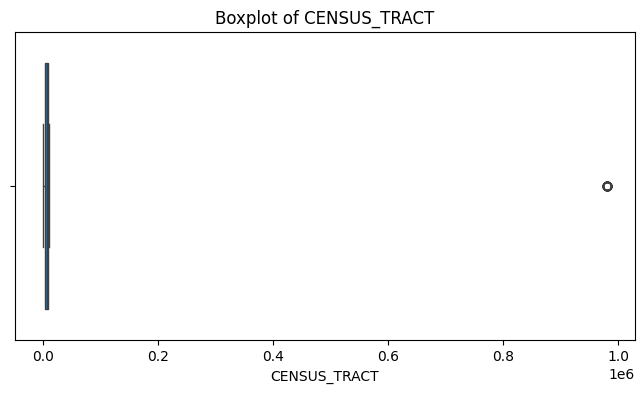

In [16]:

plt.figure(figsize=(8,4))
sns.boxplot(x=df['CENSUS_TRACT'])
plt.title('Boxplot of CENSUS_TRACT')
plt.show()


1. Most values are concentrated near zero
2. A single extreme outlier is present
3. The extreme scale difference distorts the plot

In [17]:
Q1 = df['CENSUS_TRACT'].quantile(0.25)
Q3 = df['CENSUS_TRACT'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = df[(df['CENSUS_TRACT'] < lower_bound) | (df['CENSUS_TRACT'] > upper_bound)]
print(f"Number of outliers: {len(outliers)}")
print("Outlier values:\n", outliers['CENSUS_TRACT'].unique())


Number of outliers: 37
Outlier values:
 [980000.]


##### Inspecting the outlier rows. To check whether those records: 
##### 1) Belong to correct location(using LAT/LONG)
##### 2) Or are completely mismatched(probably invalid)

In [18]:
df[df['CENSUS_TRACT'] > upper_bound][['CENSUS_TRACT', 'LATITUDE', 'LONGITUDE', 'WARD', 'DISTRICT']]


,CENSUS_TRACT,LATITUDE,LONGITUDE,WARD,DISTRICT
1011,980000.0,38.891353,-77.017558,2.0,1.0
3377,980000.0,38.892088,-77.030051,2.0,1.0
5646,980000.0,38.895501,-77.031362,2.0,2.0
5779,980000.0,38.886168,-77.033693,2.0,2.0
5944,980000.0,38.885838,-77.034947,2.0,2.0
6184,980000.0,38.887567,-77.019907,6.0,1.0
8610,980000.0,38.897341,-77.004141,6.0,1.0
9859,980000.0,38.890538,-77.021908,2.0,1.0
10608,980000.0,38.892090,-77.033653,2.0,2.0
10758,980000.0,38.887528,-77.035615,2.0,2.0


1. Identifies outlier census tracts above `upper_bound`
2. Extracts the location + administrative context
3. Helps you investigate where the extreme values occur

In [19]:
df = df[(df['CENSUS_TRACT'] >= lower_bound) & (df['CENSUS_TRACT'] <= upper_bound)]


This line **removes outliers** from the `CENSUS_TRACT` column by keeping only the values within a defined acceptable range.

In [20]:
df.describe()

,X,Y,XBLOCK,YBLOCK,WARD,DISTRICT,PSA,CENSUS_TRACT,LATITUDE,LONGITUDE,OBJECTID
count,29229.000000,29229.000000,29229.000000,29229.000000,29229.000000,29229.000000,29229.000000,29229.000000,29229.000000,29229.000000,2.922900e+04
mean,399281.925759,137806.304800,399281.925759,137806.304800,4.394471,3.705943,375.176640,6292.034760,38.908111,-77.008286,8.209456e+08
std,3032.411004,3343.733389,3032.411004,3343.733389,2.322527,1.842873,183.810194,3167.038172,0.030120,0.034964,1.083302e+05
min,390362.150000,127300.240000,390362.150000,127300.240000,1.000000,1.000000,101.000000,101.000000,38.813473,-77.111162,8.205185e+08
25%,397228.970000,136255.280000,397228.970000,136255.280000,2.000000,2.000000,207.000000,3500.000000,38.894143,-77.031952,8.208533e+08
50%,399029.400000,137857.390000,399029.400000,137857.390000,5.000000,4.000000,401.000000,7202.000000,38.908573,-77.011189,8.208764e+08
75%,401207.000000,139819.120000,401207.000000,139819.120000,6.000000,5.000000,506.000000,9102.000000,38.926245,-76.986092,8.210508e+08
max,407806.750900,147365.030000,407806.750900,147365.030000,8.000000,7.000000,708.000000,11100.000000,38.994217,-76.910012,8.211002e+08


The cleaned dataset shows more accurate and stable distributions across all numerical variables. The removal of extreme outliers and targeted imputation for `DISTRICT` and `PSA` improved the dataset quality without altering underlying patterns. The data is now well-structured and ready for modeling, mapping, and deeper exploratory analysis.

In [21]:
df['REPORT_DAT'] = pd.to_datetime(df['REPORT_DAT'], errors='coerce')

df = df.assign(
    YEAR=df['REPORT_DAT'].dt.year,
    MONTH=df['REPORT_DAT'].dt.month,
    WEEK=df['REPORT_DAT'].dt.isocalendar().week,
    DAY=df['REPORT_DAT'].dt.day,
    HOUR=df['REPORT_DAT'].dt.hour,
    DAY_OF_WEEK=df['REPORT_DAT'].dt.day_name(),
    IS_WEEKEND=df['REPORT_DAT'].dt.dayofweek >= 5,
    SEASON=df['REPORT_DAT'].dt.month.map({
        12: 'Winter', 1: 'Winter', 2: 'Winter',
        3: 'Spring', 4: 'Spring', 5: 'Spring',
        6: 'Summer', 7: 'Summer', 8: 'Summer',
        9: 'Autumn', 10: 'Autumn', 11: 'Autumn'
    })
)


In [22]:
district_names = {
    1: 'First District (SW & Downtown)',
    2: 'Second District (Northwest)',
    3: 'Third District (Adams Morgan / Columbia Heights)',
    4: 'Fourth District (Petworth / Brightwood)',
    5: 'Fifth District (Northeast)',
    6: 'Sixth District (Hillcrest / East Capitol)',
    7: 'Seventh District (Anacostia / Congress Heights)'
}

df['DISTRICT_NAME'] = df['DISTRICT'].map(district_names)


In [23]:
df.columns

Index(['X', 'Y', 'REPORT_DAT', 'SHIFT', 'METHOD', 'OFFENSE', 'BLOCK', 'XBLOCK',
       'YBLOCK', 'WARD', 'ANC', 'DISTRICT', 'PSA', 'NEIGHBORHOOD_CLUSTER',
       'BLOCK_GROUP', 'CENSUS_TRACT', 'VOTING_PRECINCT', 'LATITUDE',
       'LONGITUDE', 'START_DATE', 'END_DATE', 'OBJECTID', 'YEAR', 'MONTH',
       'WEEK', 'DAY', 'HOUR', 'DAY_OF_WEEK', 'IS_WEEKEND', 'SEASON',
       'DISTRICT_NAME'],
      dtype='object')

In [24]:
# Count crimes per offense
offense_count = df['OFFENSE'].value_counts().reset_index()
offense_count.columns = ['OFFENSE', 'COUNT']
offense_count


,OFFENSE,COUNT
0,THEFT/OTHER,12987
1,THEFT F/AUTO,6663
2,MOTOR VEHICLE THEFT,5115
3,ROBBERY,2104
4,ASSAULT W/DANGEROUS WEAPON,1023
5,BURGLARY,1005
6,HOMICIDE,187
7,SEX ABUSE,141
8,ARSON,4


# Visualization

In Visualization part I used following packages:
- Matplotlib: A powerful Python library used for creating static, customized 2D plots and visualizations.
- Seaborn: A statistical visualization library built on top of Matplotlib that provides attractive, high-level plots.
- Plotly: An interactive plotting library that enables dynamic, zoomable, web-based visualizations.
- Folium: A Python library for creating interactive maps using location data and Leaflet.js.

C:\Users\Akhila Ulpara\AppData\Local\Temp\ipykernel_11008\3276990582.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=offense_count.head(15), x='OFFENSE', y='COUNT', palette='viridis')


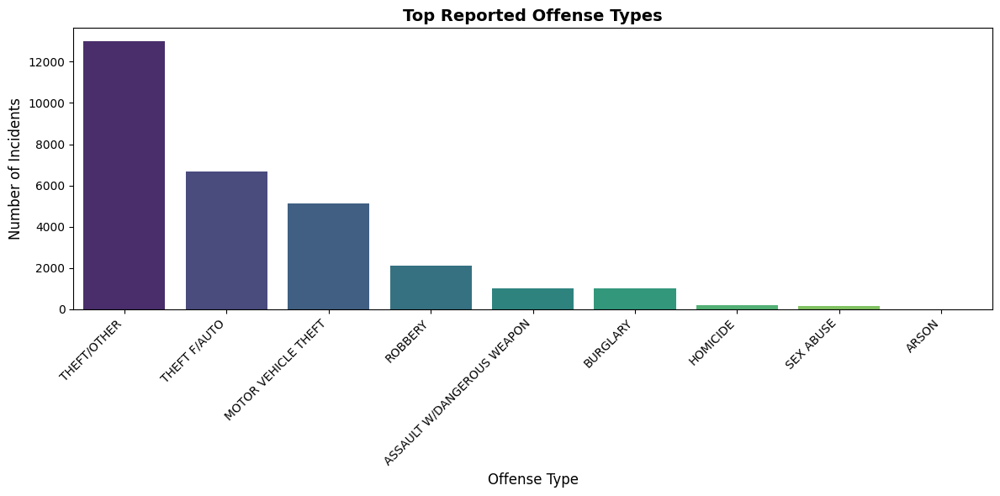

In [25]:
plt.figure(figsize=(12,6))
sns.barplot(data=offense_count.head(15), x='OFFENSE', y='COUNT', palette='viridis')
plt.title('Top Reported Offense Types', fontsize=14, fontweight='bold')
plt.xlabel('Offense Type', fontsize=12)
plt.ylabel('Number of Incidents', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [26]:
shift_count = df['SHIFT'].value_counts().reset_index()
shift_count.columns = ['SHIFT', 'COUNT']
shift_count

,SHIFT,COUNT
0,EVENING,11825
1,DAY,11489
2,MIDNIGHT,5915


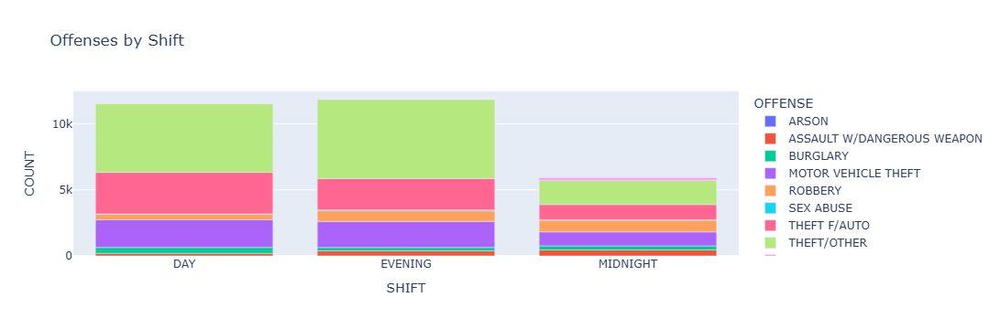

In [27]:
offense_shift= ( df.groupby(['SHIFT','OFFENSE']).size().reset_index(name='COUNT') )

px.bar(offense_shift, x='SHIFT', y='COUNT', color='OFFENSE', title='Offenses by Shift')


- There are more `THEFT/OTHER` offenses irrespective of time-of-day.
- Following with `MOTOR VEHICLE THEFT`

                                      DISTRICT_NAME  COUNT
6  Third District (Adams Morgan / Columbia Heights)   5279
3                       Second District (Northwest)   5104
0                        Fifth District (Northeast)   4721
1                    First District (SW & Downtown)   3848
2           Fourth District (Petworth / Brightwood)   3653
5         Sixth District (Hillcrest / East Capitol)   3380
4   Seventh District (Anacostia / Congress Heights)   1889


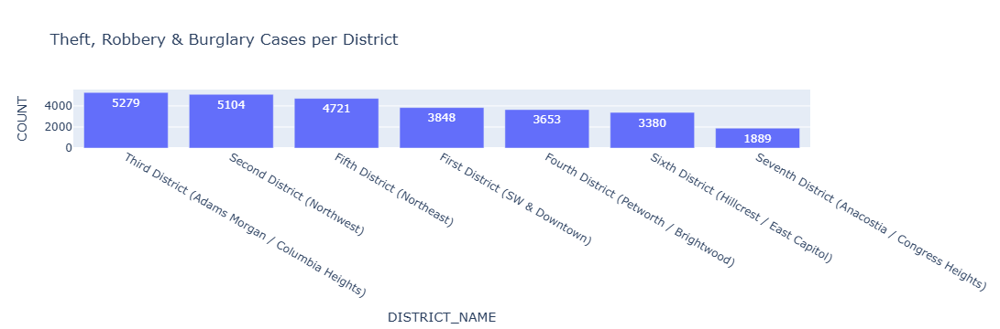

In [28]:
crime_types = ['THEFT', 'ROBBERY', 'BURGLARY']
crime_df = df[df['OFFENSE'].str.contains('|'.join(crime_types), case=False, na=False)]

# Count per district
district_crime = crime_df.groupby('DISTRICT_NAME')['OFFENSE'].count().reset_index(name='COUNT')

# Sort by count
district_crime = district_crime.sort_values('COUNT', ascending=False)

# Display top districts
print(district_crime)

# Visualize
px.bar(district_crime, x='DISTRICT_NAME', y='COUNT',
       title='Theft, Robbery & Burglary Cases per District',
       text='COUNT')

In [29]:
# Filter for selected offenses
selected_offenses = ['ASSAULT', 'HOMICIDE', 'SEX ABUSE', 'ARSON']
crime_types = df[df['OFFENSE'].str.upper().isin(selected_offenses)]

# Group by district and offense
district_crimes = crime_types.groupby(['DISTRICT_NAME', 'OFFENSE']).size().reset_index(name='COUNT')



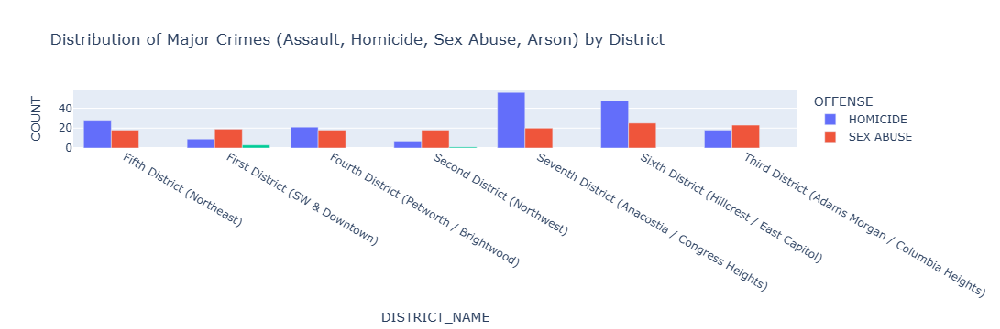

In [30]:
px.bar(
    district_crimes,
    x='DISTRICT_NAME', y='COUNT', color='OFFENSE',
    title='Distribution of Major Crimes (Assault, Homicide, Sex Abuse, Arson) by District',
    barmode='group'
)


C:\Users\Akhila Ulpara\AppData\Local\Temp\ipykernel_11008\3468667664.py:5: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



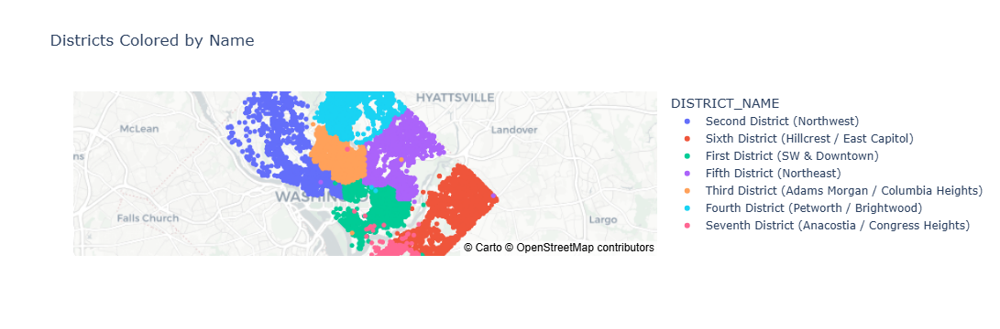

In [31]:
district_map = df.groupby('DISTRICT_NAME')[['LATITUDE', 'LONGITUDE']].mean().reset_index()
district_map['COUNT'] = df['DISTRICT_NAME'].value_counts().reindex(district_map['DISTRICT_NAME']).values


px.scatter_mapbox(
    df,
    lat='LATITUDE', lon='LONGITUDE',
    color='DISTRICT_NAME',
    mapbox_style='carto-positron',
    title='Districts Colored by Name',
    zoom=10
)


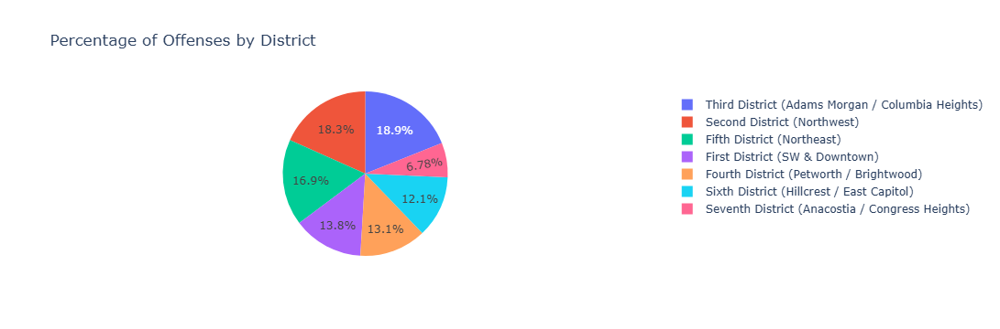

In [32]:
district_counts = crime_df['DISTRICT_NAME'].value_counts().reset_index()
district_counts.columns = ['DISTRICT_NAME', 'COUNT']
px.pie(
    district_counts,
    names='DISTRICT_NAME',
    values='COUNT',
    title='Percentage of Offenses by District'
)

In [33]:
method_counts= df['METHOD'].value_counts()
method_counts

METHOD
OTHERS    26631
GUN        2182
KNIFE       416
Name: count, dtype: int64

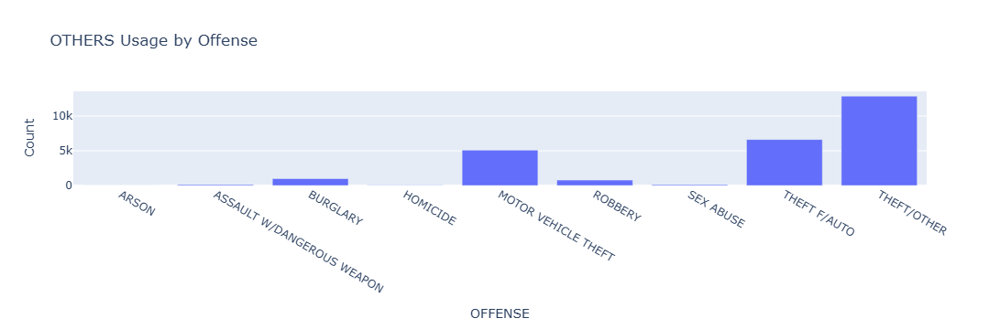

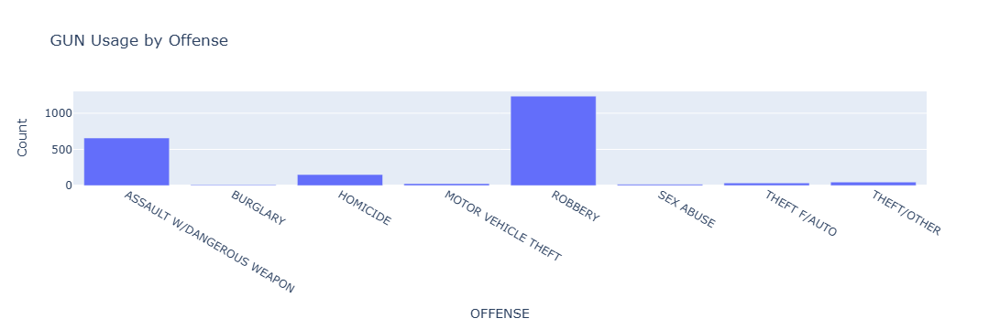

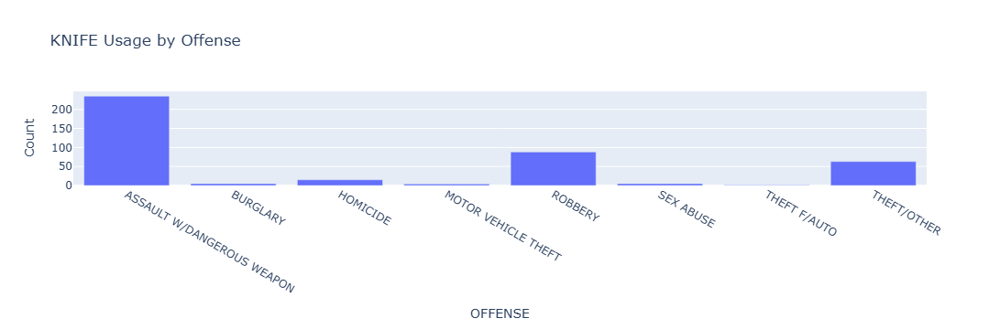

In [34]:
method_per_offense = df.groupby(['OFFENSE', 'METHOD']).size().reset_index(name='Count')


for method in method_per_offense['METHOD'].unique():
    temp = method_per_offense[method_per_offense['METHOD'] == method]
    fig = px.bar(temp, x='OFFENSE', y='Count', title=f'{method} Usage by Offense')
    fig.show()

In [35]:
gun_df = df[df['METHOD'].str.contains('GUN', case=False, na=False)]

gun_usage = gun_df.groupby('DISTRICT_NAME').size().reset_index(name='GUN_CASES')



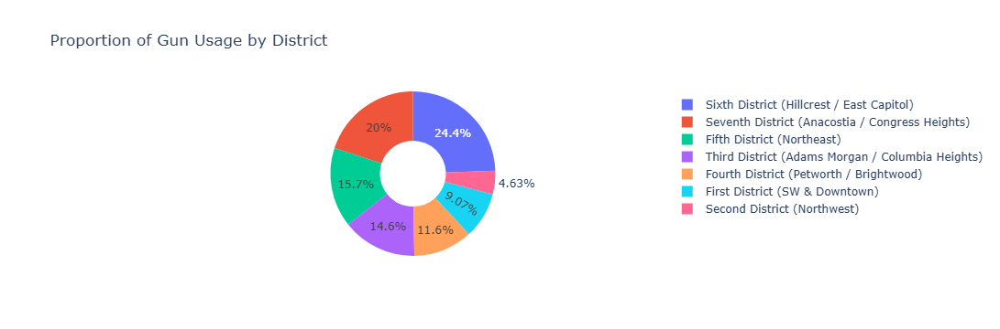

In [36]:
import plotly.express as px

px.pie(
    gun_usage,
    names='DISTRICT_NAME',
    values='GUN_CASES',
    title='Proportion of Gun Usage by District',
    hole=0.4  # makes it a donut chart
)


**Sixth District ( Hillcrest/East Capitol)** has 24.4% usage of gun 

In [37]:

non_violent = ['THEFT', 'ROBBERY', 'BURGLARY']
df['CRIME_TYPE'] = df['OFFENSE'].apply(
    lambda x: 'Non-Violent' if any(word in str(x).upper() for word in non_violent) else 'Violent'
)
method_offense_type = df.groupby(['OFFENSE', 'METHOD', 'CRIME_TYPE']).size().reset_index(name='Count')

df['CRIME_TYPE'].value_counts()



CRIME_TYPE
Non-Violent    27874
Violent         1355
Name: count, dtype: int64

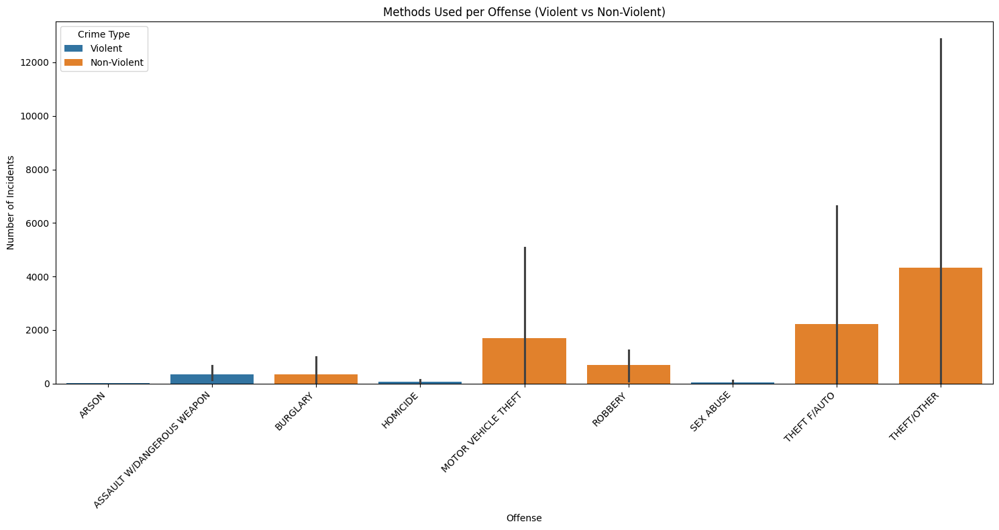

In [38]:
plt.figure(figsize=(15,8))
sns.barplot(
    data=method_offense_type,
    x='OFFENSE',
    y='Count',
    hue='CRIME_TYPE'
)
plt.xticks(rotation=45, ha='right')
plt.title('Methods Used per Offense (Violent vs Non-Violent)')
plt.ylabel('Number of Incidents')
plt.xlabel('Offense')
plt.legend(title='Crime Type')
plt.tight_layout()
plt.show()


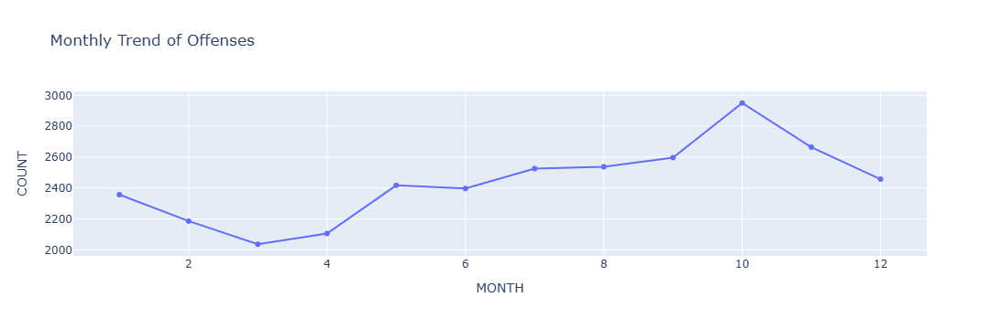

In [39]:
month_trend = df.groupby('MONTH').size().reset_index(name='COUNT')
px.line(month_trend, x='MONTH', y='COUNT', markers=True, title='Monthly Trend of Offenses')

- In September there is a significant rise in the crime.
- It peaked in October
- March has lower offence rate out of all months 

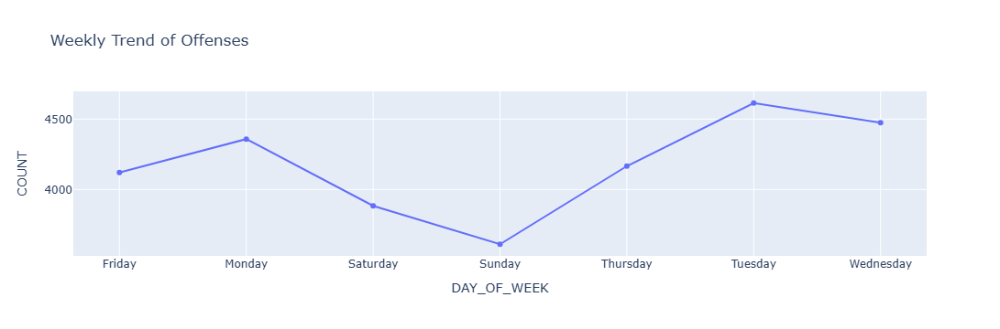

In [40]:
week_trend = df.groupby('DAY_OF_WEEK').size().reset_index(name='COUNT')
px.line(week_trend, x='DAY_OF_WEEK', y='COUNT', markers=True, title='Weekly Trend of Offenses')

Weekends have lower crime rate 

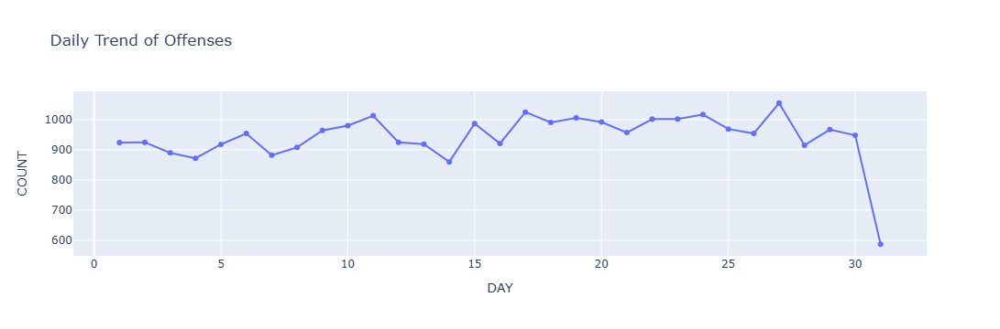

In [41]:
day_trend = df.groupby('DAY').size().reset_index(name='COUNT')
px.line(day_trend, x='DAY', y='COUNT', markers=True, title='Daily Trend of Offenses')

From the above visualization, we can say on `avg` there are 900 offenses per month

In [42]:
reports_per_psa = df.groupby('PSA')['REPORT_DAT'].count().reset_index(name='REPORT_COUNT')
reports_per_psa.head(5)

,PSA,REPORT_COUNT
0,101.0,425
1,102.0,278
2,103.0,276
3,104.0,690
4,105.0,273


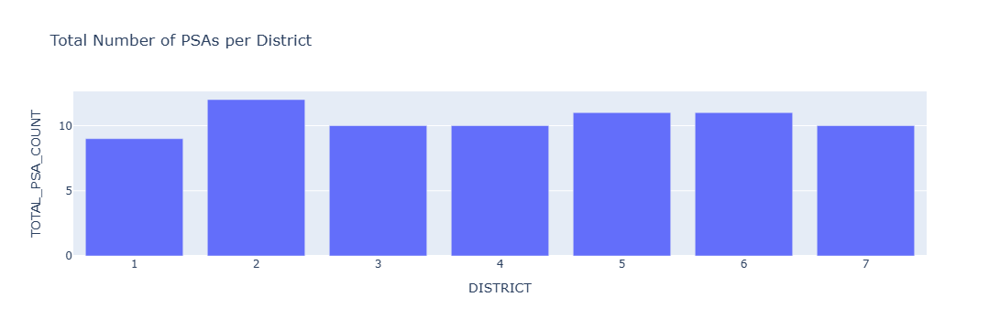

In [43]:
total_psa = df.groupby('DISTRICT')['PSA'].nunique().reset_index(name='TOTAL_PSA_COUNT')
px.bar(total_psa, x='DISTRICT', y='TOTAL_PSA_COUNT',
       title='Total Number of PSAs per District')


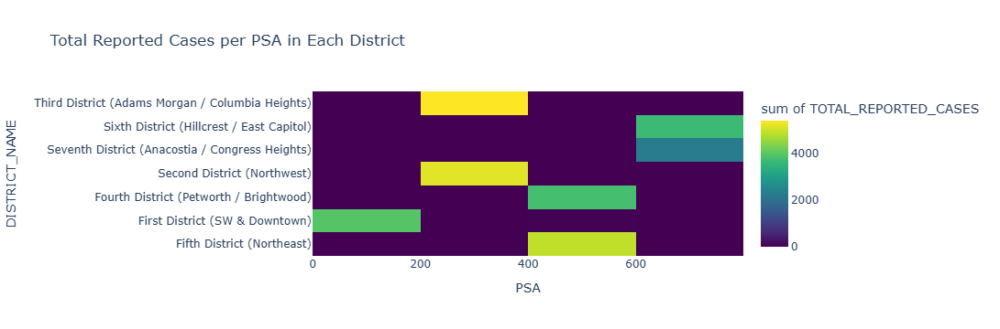

In [44]:
cases_per_psa = df.groupby(['DISTRICT_NAME', 'PSA'])['REPORT_DAT'].count().reset_index(name='TOTAL_REPORTED_CASES')

px.density_heatmap(
    cases_per_psa,
    x='PSA', y='DISTRICT_NAME', z='TOTAL_REPORTED_CASES',
    color_continuous_scale='Viridis',
    title='Total Reported Cases per PSA in Each District'
)


- The heatmap visualizes the total number of reported crime cases across different Police Service Areas (PSAs) within each police district. The color intensity represents crime volume, where darker colors indicate low or no cases, and brighter colors (green to yellow) represent higher crime counts.

- A few  particularly in the Second, Third, Fifth, and Sixth Districts—show significantly elevated crime levels, highlighted in yellow. In contrast, most district–PSA combinations appear dark, indicating low or minimal reported cases. This pattern shows that crime is not evenly distributed, but rather clustered in specific PSAs, forming identifiable crime hotspots.

In [45]:
crime_by_tract = df['CENSUS_TRACT'].value_counts().reset_index()
crime_by_tract.columns = ['CENSUS_TRACT', 'CRIME_COUNT']
crime_by_tract.head()


,CENSUS_TRACT,CRIME_COUNT
0,8803.0,699
1,2802.0,638
2,5802.0,589
3,10100.0,536
4,11100.0,527


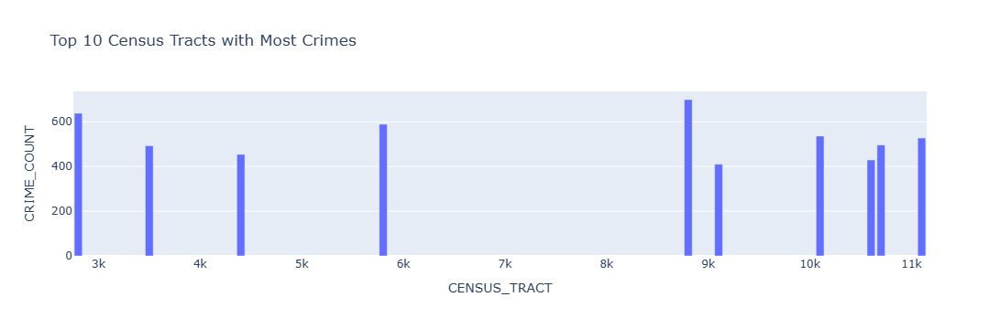

In [46]:
import plotly.express as px
px.bar(crime_by_tract.head(10), x='CENSUS_TRACT', y='CRIME_COUNT',
       title='Top 10 Census Tracts with Most Crimes')


In [47]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import folium

# Filter valid coordinates
crime_loc = df[['LATITUDE', 'LONGITUDE']].dropna()
crime_loc = crime_loc[(crime_loc['LATITUDE'] != 0) & (crime_loc['LONGITUDE'] != 0)]


- `DBSCAN` from scikit-learn for performing density-based clustering.

- `StandardScaler` to standardize coordinate values before clustering.

- `folium` for geographical visualization on an interactive map.

In [48]:
 #Convert to radians for Haversine
coords = np.radians(crime_loc[['LATITUDE', 'LONGITUDE']])

# DBSCAN parameters (tune eps)
kms_per_radian = 6371.0088
epsilon = 0.5 / kms_per_radian  # 0.5 km neighborhood

db = DBSCAN(eps=epsilon, min_samples=20, algorithm='ball_tree', metric='haversine').fit(coords)
crime_loc['CLUSTER'] = db.labels_

In [49]:
# Create base map centered on Washington DC
m = folium.Map(location=[crime_loc['LATITUDE'].mean(), crime_loc['LONGITUDE'].mean()], zoom_start=11)

# Assign colors
import matplotlib
import matplotlib.cm as cm
import matplotlib.colors as colors

n_clusters = len(set(db.labels_)) - (1 if -1 in db.labels_ else 0)
colormap = matplotlib.colormaps['Set1']
cluster_colors = [matplotlib.colors.rgb2hex(colormap(i / n_clusters)) for i in range(n_clusters)]


# Add cluster points
for _, row in crime_loc.iterrows():
    cluster = int(row['CLUSTER'])
    color = 'black' if cluster == -1 else cluster_colors[cluster % len(cluster_colors)]
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=2,
        color=color,
        fill=True,
        fill_opacity=0.6
    ).add_to(m)

m


This code generates an interactive Folium map to visualize crime hotspot clusters within Washington, D.C. using DBSCAN clustering results.

1. Base Map Creation

- A Folium map is centered on the average latitude and longitude of all crime locations.

- The initial zoom level is set to 11, giving a city-wide view.

2. Cluster Color Assignment

- The number of valid clusters is calculated from the `DBSCAN labels_`.

- A color palette (`Set1`) from Matplotlib is used to generate unique colors for each cluster.

- Outliers (label `-1`) are assigned the color black.

3. Plotting Crime Points

- Every crime record is plotted using `folium.CircleMarker`.

- Each point’s color corresponds to the cluster it belongs to.

- Points are small (radius = 2) so dense areas form visible cluster patterns.

- All markers are added to the map.

4. Final Output

- The variable `m` stores the fully interactive map, allowing zooming, panning, and exploration of crime cluster patterns.

In [50]:
m.save("crime_clusters_map.html")
